# Wallmart Sales Top 3%
- Store - the store number
- Date - the week
- Temperature - average temperature in the region
- Fuel_Price - cost of fuel in the region
- MarkDown1-5 - anonymized data related to promotional markdowns that Walmart is running. MarkDown data is only available after Nov 2011, and is not available for all stores all the time. Any missing value is marked with an NA.
- CPI - the consumer price index
- Unemployment - the unemployment rate
- IsHoliday - whether the week is a special holiday week

## 1. Libraries

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode()

# from sklearn import model_selection
# from sklearn import metrics, ensemble, linear_model
# from sklearn.experimental import enable_hist_gradient_boosting
# from sklearn.ensemble import HistGradientBoostingRegressor
import warnings
warnings.filterwarnings('ignore') 

## 2. Data Loading

In [2]:
features = pd.read_csv('./walmart_data/features.csv.zip')
train = pd.read_csv('./walmart_data/train.csv.zip')
stores = pd.read_csv('./walmart_data/stores.csv')
test = pd.read_csv('./walmart_data/test.csv.zip')
sample_submission = pd.read_csv('./walmart_data/sampleSubmission.csv.zip')

In [3]:
import os
os.getcwd()

'/Users/angela/Pandas_python/walmart_sales_EDA'

In [4]:
display(features.head(3), stores.head(3))

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False


,Store,Type,Size
0,1,A,151315
1,2,A,202307
2,3,B,37392


In [5]:
feature_store = features.merge(stores, how = 'inner', on = 'Store')
feature_store.sample(5)

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Type,Size
7793,43,2012-12-14,46.80,3.168,378.87,NaN,NaN,NaN,1051.35,215.015910,8.839,False,C,41062
3844,22,2010-07-09,79.22,2.806,NaN,NaN,NaN,NaN,NaN,136.396264,8.433,False,B,119557
544,3,2013-07-19,81.11,3.556,718.43,228.54,37.0,521.39,627.68,NaN,NaN,False,B,37392
4678,26,2012-07-20,66.75,3.610,3072.39,35.80,13.8,1032.75,3437.32,138.233193,7.405,False,A,152513
6749,38,2010-05-21,76.20,3.120,NaN,NaN,NaN,NaN,NaN,126.184387,14.099,False,C,39690


In [6]:
train.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday
0,1,1,2010-02-05,24924.50,False
1,1,1,2010-02-12,46039.49,True
2,1,1,2010-02-19,41595.55,False
3,1,1,2010-02-26,19403.54,False
4,1,1,2010-03-05,21827.90,False


In [7]:
train_df = train.merge(feature_store, how = 'inner', on = ['Store','Date','IsHoliday']).sort_values(by=['Store', 'Dept', 'Date']).reset_index(drop=True)
train_df.head()

,Store,Dept,Date,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Type,Size
0,1,1,2010-02-05,24924.50,False,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,A,151315
1,1,1,2010-02-12,46039.49,True,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,A,151315
2,1,1,2010-02-19,41595.55,False,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,A,151315
3,1,1,2010-02-26,19403.54,False,46.63,2.561,NaN,NaN,NaN,NaN,NaN,211.319643,8.106,A,151315
4,1,1,2010-03-05,21827.90,False,46.50,2.625,NaN,NaN,NaN,NaN,NaN,211.350143,8.106,A,151315


In [8]:
test_df = test.merge(feature_store, how = 'inner', on = ['Store','Date','IsHoliday']).sort_values(by = ['Store','Dept','Date']).reset_index(drop=True)
test_df.head(3)

,Store,Dept,Date,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Type,Size
0,1,1,2012-11-02,False,55.32,3.386,6766.44,5147.70,50.82,3639.90,2737.42,223.462779,6.573,A,151315
1,1,1,2012-11-09,False,61.24,3.314,11421.32,3370.89,40.28,4646.79,6154.16,223.481307,6.573,A,151315
2,1,1,2012-11-16,False,52.92,3.252,9696.28,292.10,103.78,1133.15,6612.69,223.512911,6.573,A,151315


## 3. EDA(Exploratory Data Analysis)

In [9]:
train_df.describe().T.style.bar(subset=['mean'], color = '#205ff2')\
                            .background_gradient(subset=['std'], cmap = 'Reds')\
                            .background_gradient(subset=['50%'], cmap = 'coolwarm')

,count,mean,std,min,25%,50%,75%,max
Store,421570.000000,22.200546,12.785297,1.000000,11.000000,22.000000,33.000000,45.000000
Dept,421570.000000,44.260317,30.492054,1.000000,18.000000,37.000000,74.000000,99.000000
Weekly_Sales,421570.000000,15981.258123,22711.183519,-4988.940000,2079.650000,7612.030000,20205.852500,693099.360000
Temperature,421570.000000,60.090059,18.447931,-2.060000,46.680000,62.090000,74.280000,100.140000
Fuel_Price,421570.000000,3.361027,0.458515,2.472000,2.933000,3.452000,3.738000,4.468000
MarkDown1,150681.000000,7246.420196,8291.221345,0.270000,2240.270000,5347.450000,9210.900000,88646.760000
MarkDown2,111248.000000,3334.628621,9475.357325,-265.760000,41.600000,192.000000,1926.940000,104519.540000
MarkDown3,137091.000000,1439.421384,9623.078290,-29.100000,5.080000,24.600000,103.990000,141630.610000
MarkDown4,134967.000000,3383.168256,6292.384031,0.220000,504.220000,1481.310000,3595.040000,67474.850000
MarkDown5,151432.000000,4628.975079,5962.887455,135.160000,1878.440000,3359.450000,5563.800000,108519.280000


In [10]:
feature_store.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8190 entries, 0 to 8189
Data columns (total 14 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Store         8190 non-null   int64  
 1   Date          8190 non-null   object 
 2   Temperature   8190 non-null   float64
 3   Fuel_Price    8190 non-null   float64
 4   MarkDown1     4032 non-null   float64
 5   MarkDown2     2921 non-null   float64
 6   MarkDown3     3613 non-null   float64
 7   MarkDown4     3464 non-null   float64
 8   MarkDown5     4050 non-null   float64
 9   CPI           7605 non-null   float64
 10  Unemployment  7605 non-null   float64
 11  IsHoliday     8190 non-null   bool   
 12  Type          8190 non-null   object 
 13  Size          8190 non-null   int64  
dtypes: bool(1), float64(9), int64(2), object(2)
memory usage: 903.8+ KB


In [11]:
feature_store.head(3)

,Store,Date,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,IsHoliday,Type,Size
0,1,2010-02-05,42.31,2.572,NaN,NaN,NaN,NaN,NaN,211.096358,8.106,False,A,151315
1,1,2010-02-12,38.51,2.548,NaN,NaN,NaN,NaN,NaN,211.242170,8.106,True,A,151315
2,1,2010-02-19,39.93,2.514,NaN,NaN,NaN,NaN,NaN,211.289143,8.106,False,A,151315


In [12]:
feature_store = features.merge(stores, how = 'inner', on = 'Store')

#date 컬럼을 object -> datetime으로
feature_store['Date'] = pd.to_datetime(feature_store['Date'])
train['Date'] = pd.to_datetime(train['Date'])
test['Date'] = pd.to_datetime(test['Date'])

In [13]:
#datetime에서 주요 시간데이터 추출
feature_store['Day'] = feature_store['Date'].dt.day
feature_store['Week'] = feature_store['Date'].dt.week
feature_store['Month'] = feature_store['Date'].dt.month
feature_store['Year'] = feature_store['Date'].dt.year

In [14]:
train_df = train.merge(feature_store, how = 'inner', on = ['Store','Date','IsHoliday']).sort_values(by = ['Store','Dept','Date']).reset_index(drop=True)

In [15]:
test_df = test.merge(feature_store, how = 'inner', on = ['Store','Date','IsHoliday']).sort_values(by = ['Store','Dept','Date']).reset_index(drop=True)

In [16]:
df_weeks = train_df.groupby('Week').sum()

In [17]:
palette = px.colors.qualitative.Safe

In [18]:
df_weeks.head(1)

,Store,Dept,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size,Day,Month,Year
Week,,,,,,,,,,,,,,,,,
1,130899,260501,87731209.72,0,222343.25,18872.529,14993973.93,67007392.71,353486.72,3078155.61,15506769.87,1.008962e+06,46396.361,806775433,38348,5903,11873906


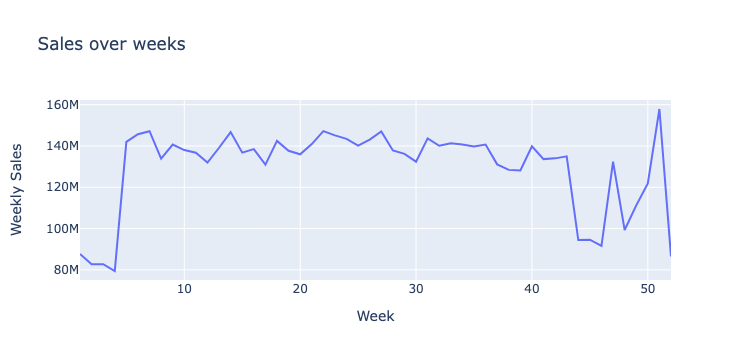

In [19]:
px.line(data_frame = df_weeks, x = df_weeks.index, y = 'Weekly_Sales',
       labels = {'Weekly_Sales':'Weekly Sales', 'x':'Weeks'},
       title = 'Sales over weeks')

#### 인사이트
- 일년동안 주간 매출이 비교적 안정적이다, 42주 부근에서 하락이 있지만, 휴일에 저어들며 회복

### Markdowns relationship with sales
- 마크다운과 매출 관계 확인

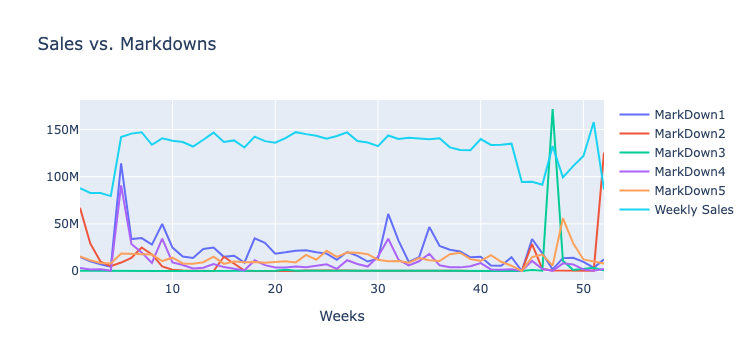

In [20]:
fig = go.Figure()
fig.add_trace(go.Scatter(x = df_weeks.index, y = df_weeks['MarkDown1'], name = 'MarkDown1', mode = 'lines'))
fig.add_trace(go.Scatter(x = df_weeks.index, y = df_weeks['MarkDown2'], name = 'MarkDown2', mode = 'lines'))
fig.add_trace(go.Scatter(x = df_weeks.index, y = df_weeks['MarkDown3'], name = 'MarkDown3', mode = 'lines'))
fig.add_trace(go.Scatter(x = df_weeks.index, y = df_weeks['MarkDown4'], name = 'MarkDown4', mode = 'lines'))
fig.add_trace(go.Scatter(x = df_weeks.index, y = df_weeks['MarkDown5'], name = 'MarkDown5', mode = 'lines'))
fig.add_trace(go.Scatter(x = df_weeks.index, y = df_weeks['Weekly_Sales'], name = 'Weekly Sales', mode = 'lines'))
fig.update_layout(title = 'Sales vs. Markdowns', xaxis_title = 'Weeks')

### Mean sales comparassion across the years
- 연중 평균 매출 비교

In [21]:
weekly_sales = train_df.groupby(['Year', 'Week'], as_index = False).agg({'Weekly_Sales':['mean', 'median']})
weekly_sales2010 = train_df.loc[train_df['Year'] == 2010].groupby(['Week']).agg({'Weekly_Sales':['mean', 'median']})
weekly_sales2011 = train_df.loc[train_df['Year'] == 2011].groupby(['Week']).agg({'Weekly_Sales':['mean', 'median']})
weekly_sales2012 = train_df.loc[train_df['Year'] == 2012].groupby(['Week']).agg({'Weekly_Sales':['mean', 'median']})

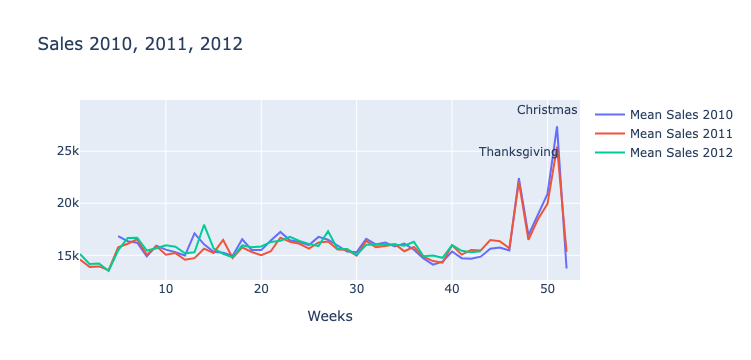

In [22]:
fig = go.Figure()
fig.add_trace(go.Scatter( x = weekly_sales2010['Weekly_Sales']['mean'].index, 
                        y = weekly_sales2010['Weekly_Sales']['mean'],
                        name = 'Mean Sales 2010', mode = 'lines'))

fig.add_trace(go.Scatter( x = weekly_sales2011['Weekly_Sales']['mean'].index, 
                        y = weekly_sales2011['Weekly_Sales']['mean'],
                        name = 'Mean Sales 2011', mode = 'lines'))

fig.add_trace(go.Scatter( x = weekly_sales2012['Weekly_Sales']['mean'].index, 
                        y = weekly_sales2012['Weekly_Sales']['mean'],
                        name = 'Mean Sales 2012', mode = 'lines'))

fig.add_annotation(text = "Thanksgiving", x = 47, y = 25000, showarrow = False)
fig.add_annotation(text = 'Christmas', x = 50, y = 29000, showarrow = False)
fig.update_layout(title = 'Sales 2010, 2011, 2012', xaxis_title = 'Weeks')

#### 인사이트
- 연간 매출에 확실히 패턴이 보인다. 추수감사절과 크리스마스에 아주 크게 매출이 증가한다

### Other Features Analysis

In [23]:
#온도를 섭씨로 바꾸기
train_df['Temperature'] = train_df['Temperature'].apply(lambda x : ( x - 32) / 1.8)
test_df['Temperature'] = test_df['Temperature'].apply(lambda x : ( x - 32) / 1.8)

In [24]:
test_df.sample(3)

,Store,Dept,Date,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Type,Size,Day,Week,Month,Year
9177,4,30,2013-06-21,False,26.166667,3.453,3423.81,176.93,457.43,7953.47,5443.06,NaN,NaN,A,205863,21,25,6,2013
109043,43,16,2013-03-08,False,15.511111,3.658,234.79,NaN,73.33,NaN,1037.07,216.002541,8.934,C,41062,8,10,3,2013
7650,3,81,2013-03-29,False,15.938889,3.606,2177.83,NaN,199.96,103.87,672.00,228.555913,6.108,B,37392,29,13,3,2013


In [25]:
train_plt = train_df.sample(frac = 0.20)
#전체 데이터 중에서 20%를 추출

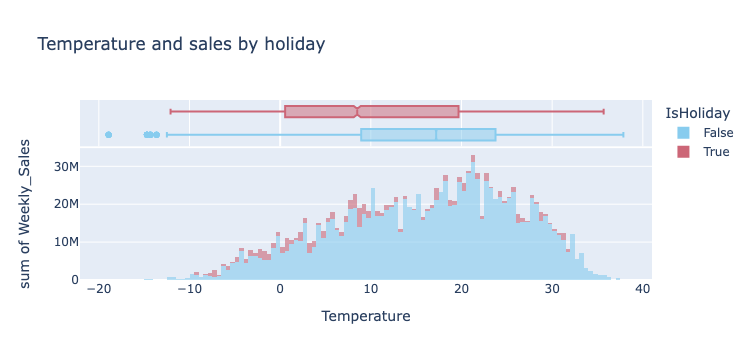

In [26]:
px.histogram(train_plt, x='Temperature', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title = 'Temperature and sales by holiday', color_discrete_sequence=palette)

#### 인사이트 
- 매출과 온도(추운정도)에 확실히 관계가 있다. 날이 따뜻해지면 매출이 올라가는 경향이 있음}

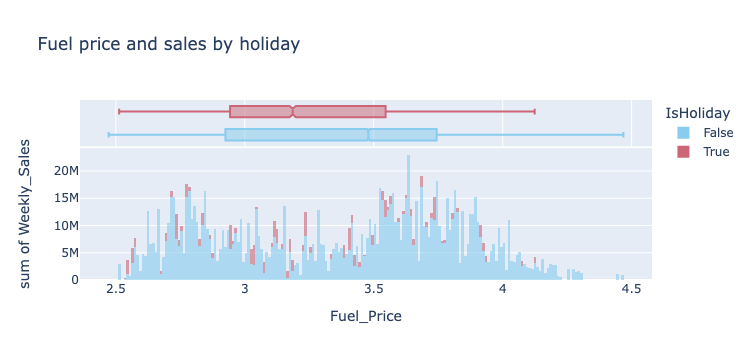

In [27]:
px.histogram(train_plt, x='Fuel_Price', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='Fuel price and sales by holiday',color_discrete_sequence=palette)

#### 인사이트
- 확실한 패턴은 보이지 않지만, 원유가격이 낮아지면 매출이 오르는 경향이 있어보임

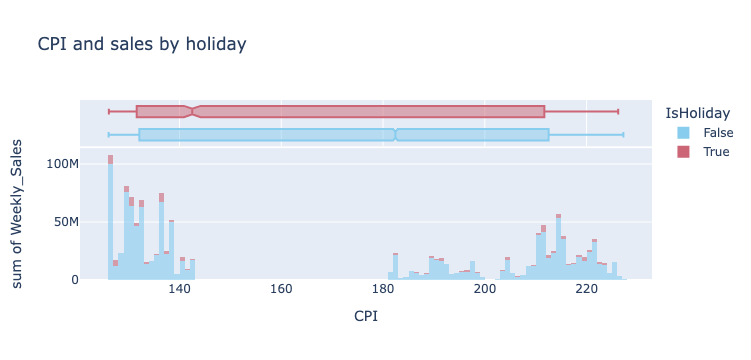

In [28]:
px.histogram(train_plt, x='CPI', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='CPI and sales by holiday',color_discrete_sequence=palette)

#### 인사이트
- 확실한 패턴은 보이지 않음
- 3개 그룹으로 나눠볼 수 있음 ; 그런데 CPI가 높다고, 매출이 확실히 증가한다고 볼 수는 없다

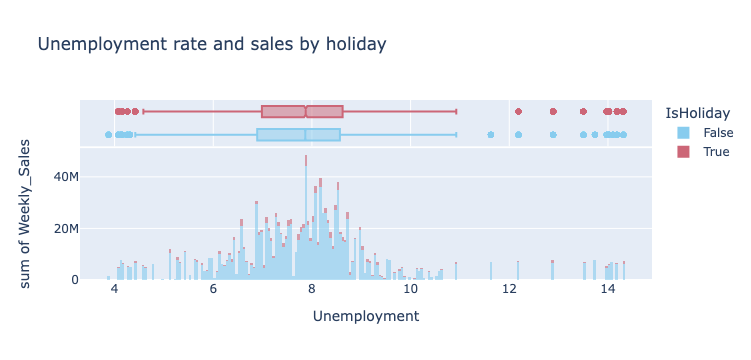

In [29]:
px.histogram(train_plt, x = 'Unemployment', y = 'Weekly_Sales', color = 'IsHoliday', marginal='box', opacity = 0.6,
            title = 'Unemployment rate and sales by holiday', color_discrete_sequence=palette)

#### 인사이트
- 실업률이 일정 수준 이상 높아지면, 매출은 줄고 / 낮아지면 높아짐을 확인

In [30]:
sizes = train_plt.groupby('Size').mean()
sizes.head()

,Store,Dept,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Day,Week,Month,Year
Size,,,,,,,,,,,,,,,,,
34875,5.000000,41.053733,4836.449972,0.071267,20.544812,3.216038,3149.905361,1229.898345,781.322985,1225.279098,2605.519502,216.463883,6.306093,15.613688,25.735294,6.431561,2010.949095
37392,3.000000,40.954698,6502.268182,0.067114,21.818432,3.206900,3269.880689,1171.377600,984.075829,966.748129,1233.507787,219.233143,7.186201,15.932886,25.416667,6.347875,2010.941834
39690,37.778644,47.403969,8548.252249,0.073707,22.559247,3.592178,362.326099,452.916490,14.981520,56.219511,1480.375207,128.711125,10.106078,15.639972,25.792346,6.442240,2010.977557
39910,39.152910,46.750426,8394.863903,0.065498,18.489012,3.245524,399.019552,284.415794,18.379595,50.320723,1207.785205,184.604733,7.470920,15.528853,25.748722,6.436328,2010.974190
41062,43.000000,47.258868,12562.198672,0.069434,20.631346,3.211368,345.088806,631.757295,10.698284,179.460741,1274.046716,207.701664,9.925438,15.427925,25.851321,6.463396,2010.954717


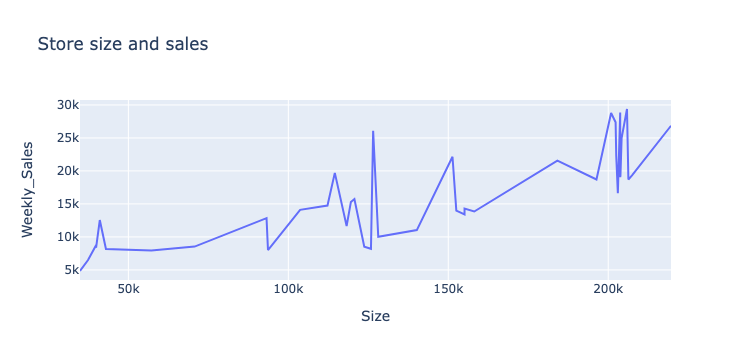

In [31]:
px.line(sizes, x = sizes.index, y = sizes.Weekly_Sales, title = 'Store size and sales')

#### 인사이트
- 사이즈는 매출에 관하여 중요한 변수임을 알 수 있다!

In [32]:
store_type = pd.concat([stores['Type'], stores['Size']], axis = 1)
store_type.head()

,Type,Size
0,A,151315
1,A,202307
2,B,37392
3,A,205863
4,B,34875


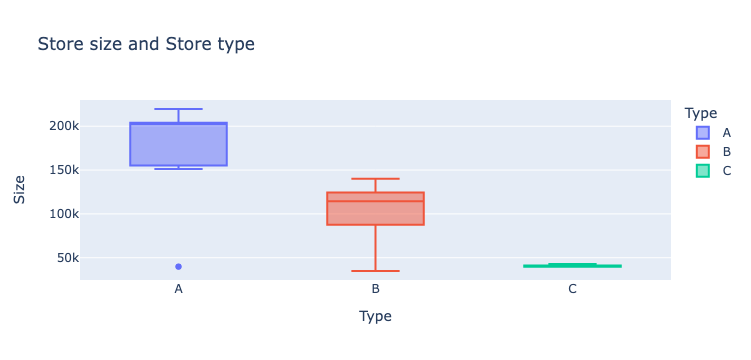

In [33]:
px.box(store_type, x = 'Type', y = 'Size', color = 'Type', title = 'Store size and Store type')

- 3가지 유형의 매장이 있으며, A가 사이즈가 가장 크다

In [34]:
store_sales = pd.concat([stores['Type'], train_df['Weekly_Sales']], axis = 1)
store_sales.head()

,Type,Weekly_Sales
0,A,24924.50
1,A,46039.49
2,B,41595.55
3,A,19403.54
4,B,21827.90


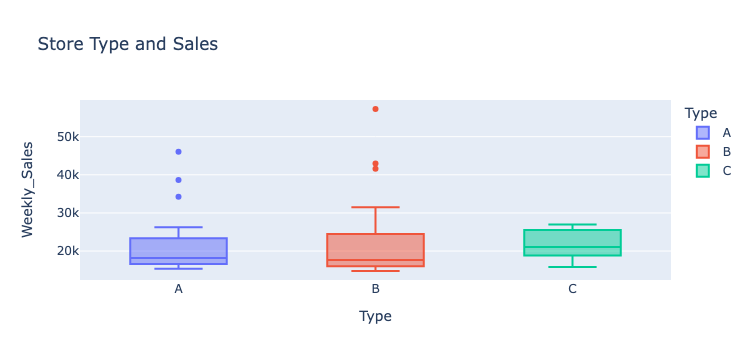

In [35]:
px.box(store_sales, x = 'Type', y = 'Weekly_Sales', color = 'Type', title = 'Store Type and Sales')

- C유형 매장이 사이즈가 가장 작음에도 불구하고, 매출 중앙값은 가장 높다

In [36]:
depts = train_plt.groupby('Dept').mean().sort_values(by = 'Weekly_Sales', ascending = False)
depts.head()

,Store,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size,Day,Week,Month,Year
Dept,,,,,,,,,,,,,,,,,
92,22.945905,73355.365026,0.073629,16.412509,3.354171,7195.022829,2939.441560,1379.589834,3461.581106,4184.563854,174.253259,8.036379,128763.738542,15.613824,25.984222,6.488355,2010.954170
95,23.388071,69686.980480,0.081332,16.022958,3.365256,6905.364759,3335.931683,1555.243783,3449.503429,5062.866870,169.653336,8.070763,130207.613478,15.600310,26.045701,6.502711,2010.966692
38,23.170543,60134.155899,0.075969,16.031873,3.342082,6791.427613,3095.943631,1602.637943,3260.265379,4250.542149,171.534711,7.988222,131895.154264,15.682946,25.989147,6.486822,2010.951938
72,22.507321,50062.400181,0.062877,15.315767,3.342604,7163.890100,3084.970651,1165.211598,3289.752397,4523.666104,172.181139,7.944468,135282.305771,15.654608,25.556417,6.389320,2010.951766
90,23.055178,46150.183273,0.083144,15.510624,3.345700,7002.246073,3300.055807,1170.462525,3510.848731,5049.191474,171.270746,7.952741,132628.808012,15.737717,25.610733,6.397581,2010.947846


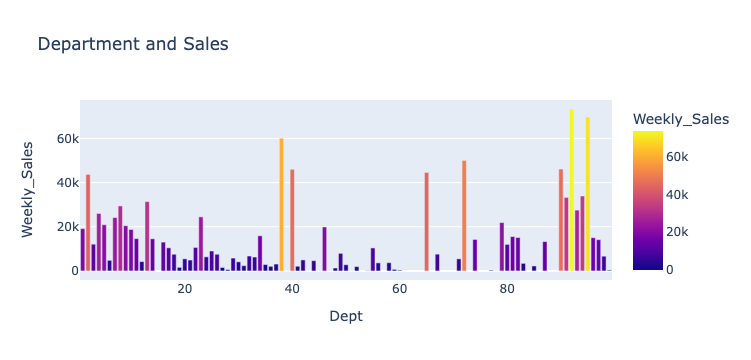

In [37]:
bar = px.bar(depts, x = depts.index, y = depts.Weekly_Sales, title = 'Department and Sales',
            color = depts.Weekly_Sales)
bar.update_layout(barmode = 'group', xaxis = {'categoryorder' : 'total descending'})

- 어떤 부서가 다른 부서들에 비해 총 매출에 큰 기여를 하고 있음을 알 수 있다

### Heatmap and correlation between features

- mask = np.triu(np.ones_like(corr, dtype=bool))
    - np.ones_like(corr, dtype=bool)는 corr 행렬과 같은 크기의 모든 요소가 True인 불리언 행렬(배열)을 생성
    - np.triu() 함수는 이 불리언 행렬에서 상삼각행렬(upper triangular matrix) 부분만 남기고 나머지 부분을 False로 채움
    - 결국, mask는 상삼각행렬 부분이 True이고 나머지 부분이 False인 불리언 행렬이 됩니다.
    
- df_mask = corr.mask(mask).round(2)
    - corr.mask(mask)는 corr 행렬에서 mask 행렬이 True인 위치의 값을 NaN으로 대체합니다. 이렇게 함으로써 상삼각행렬 부분의 값들을 가려서 표시되지 않도록 합니다.
    - .round(2)는 모든 숫자 값을 소수점 아래 2자리까지 반올림하여 표시

- 따라서, df_mask는 상삼각행렬 부분의 값들이 가려진 상태에서 소수점 둘째 자리까지 반올림된 값을 가지는 행렬이 됨

In [39]:
corr = train_df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
df_mask = corr.mask(mask).round(2)
df_mask

,Store,Dept,Weekly_Sales,IsHoliday,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size,Day,Week,Month,Year
Store,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Dept,0.02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Weekly_Sales,-0.09,0.15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
IsHoliday,-0.00,0.00,0.01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Temperature,-0.05,0.00,-0.00,-0.16,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Fuel_Price,0.07,0.00,-0.00,-0.08,0.14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MarkDown1,-0.12,-0.00,0.09,-0.04,-0.04,0.06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MarkDown2,-0.04,0.00,0.02,0.33,-0.32,-0.22,0.02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MarkDown3,-0.03,0.00,0.06,0.43,-0.10,-0.10,-0.11,-0.05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MarkDown4,-0.01,0.00,0.05,-0.00,-0.06,-0.04,0.82,-0.01,-0.07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


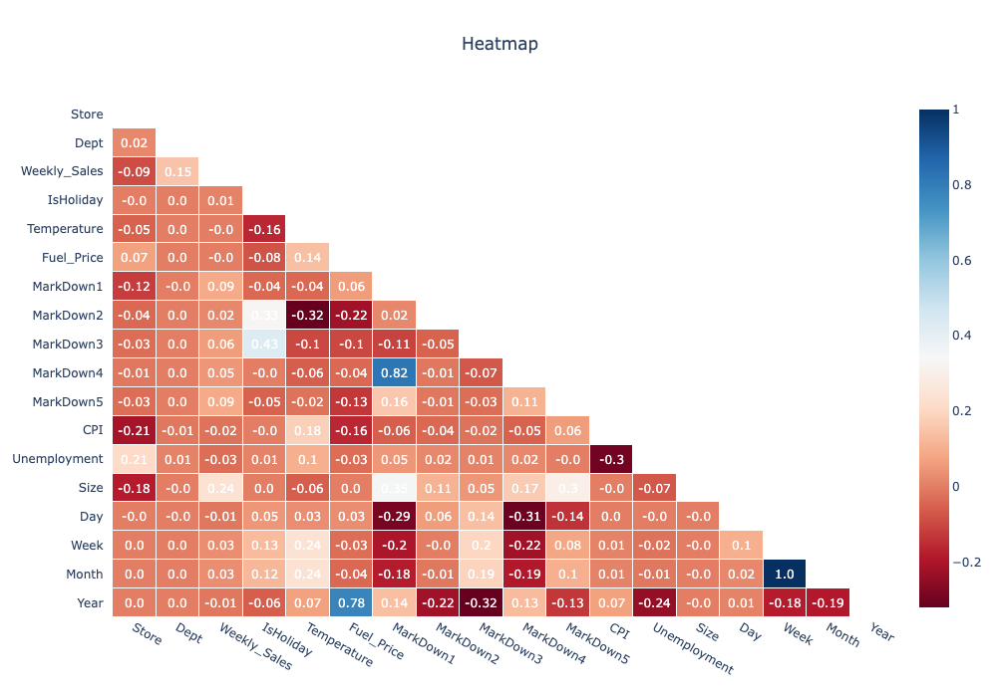

In [48]:
fig = ff.create_annotated_heatmap(z = df_mask.to_numpy(),
                                 x = df_mask.columns.tolist(),
                                 y = df_mask.columns.tolist(),
                                 colorscale = px.colors.diverging.RdBu,
                                 hoverinfo="none",
                                 showscale=True, ygap = 1, xgap = 1)

fig.update_xaxes(side="bottom")

fig.update_layout(
    title_text = 'Heatmap',
    title_x = 0.5, 
    width = 900,
    height = 700,
    xaxis_showgrid = False,
    yaxis_showgrid = False,
    xaxis_zeroline = False,
    yaxis_zeroline = False,
    yaxis_autorange = 'reversed',
    template = 'plotly_white'
)


for i in range(len(fig.layout.annotations)):
    if fig.layout.annotations[i].text == 'nan':
        fig.layout.annotations[i].text = ""
        
fig.show()

In [61]:
weekly_sales_corr = train_df.corr().iloc[2, :]
corr_df = pd.DataFrame(data = weekly_sales_corr, index = weekly_sales_corr.index).sort_values(by = 'Weekly_Sales', ascending = False)

print(type(weekly_sales_corr))
corr_df.head(3)

<class 'pandas.core.series.Series'>


,Weekly_Sales
Weekly_Sales,1.000000
Size,0.243828
Dept,0.148032


In [62]:
corr_df = corr_df.iloc[1:]
corr_df

,Weekly_Sales
Size,0.243828
Dept,0.148032
MarkDown5,0.090362
MarkDown1,0.085251
MarkDown3,0.060385
MarkDown4,0.045414
Month,0.028409
Week,0.027673
MarkDown2,0.024130
IsHoliday,0.012774


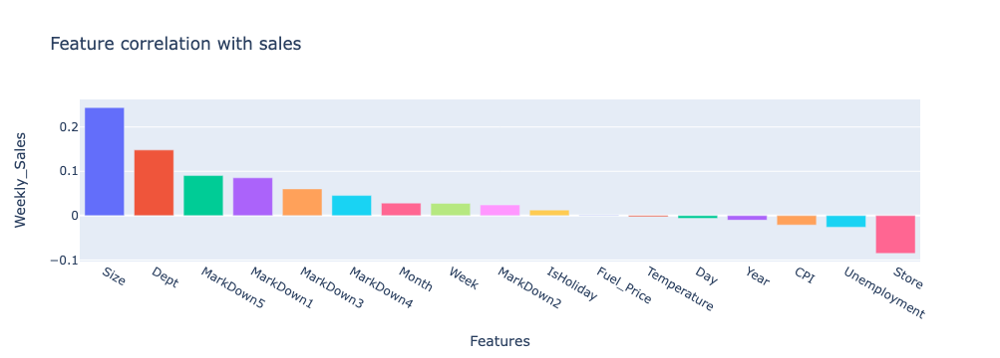

In [67]:
bar = px.bar(corr_df, x = corr_df.index, y = 'Weekly_Sales', color = corr_df.index, labels = {'index':'Features'},
            title = 'Feature correlation with sales')
#labels = {'index':'Features'} >> 바 차트의 x축 레이블을 'Features'로 표시하도록 설정

bar.update_traces(showlegend=False)

### Feature Engineering